In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
%matplotlib inline
from memory_profiler import memory_usage
import os
import pandas as pd
from glob import glob
import numpy as np

In [3]:
import pandas as pd
import numpy as np

pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import MinMaxScaler

In [4]:
# Libraries for Classification and building Models

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Flatten, Dense, MaxPool2D, Dropout
from tensorflow.keras.utils import to_categorical 

from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
# Project Specific Libraries

import os
import librosa
import librosa.display
import glob 
import skimage

In [5]:
df = pd.read_csv("../input/urbansound8k/UrbanSound8K.csv")
df.head()

,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.0,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.5,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.5,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.0,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.5,72.500000,1,5,2,children_playing


In [6]:
dat1, sampling_rate1 = librosa.load('../input/urbansound8k/fold5/100032-3-0-0.wav')
dat2, sampling_rate2 = librosa.load('../input/urbansound8k/fold5/100263-2-0-117.wav')

Text(0.5, 1.0, 'Linear-frequency power spectrogram')

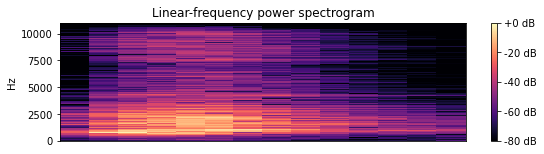

In [7]:
plt.figure(figsize=(20, 10))
D = librosa.amplitude_to_db(np.abs(librosa.stft(dat1)), ref=np.max)
plt.subplot(4, 2, 1)
librosa.display.specshow(D, y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

Text(0.5, 1.0, 'Linear-frequency power spectrogram')

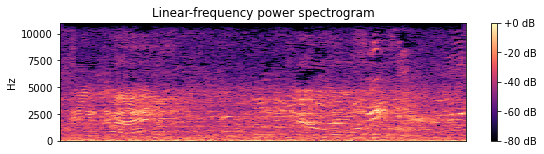

In [8]:
plt.figure(figsize=(20, 10))
D = librosa.amplitude_to_db(np.abs(librosa.stft(dat2)), ref=np.max)
plt.subplot(4, 2, 1)
librosa.display.specshow(D, y_axis='linear')
plt.colorbar(format='%+2.0f dB')
plt.title('Linear-frequency power spectrogram')

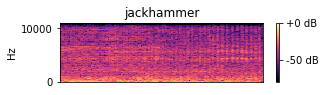

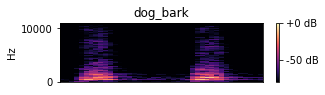

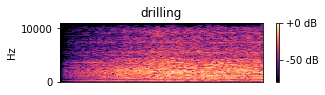

In [9]:
arr = np.array(df["slice_file_name"])
fold = np.array(df["fold"])
cla = np.array(df["class"])

for i in range(192, 197, 2):
    path = '../input/urbansound8k/fold' + str(fold[i]) + '/' + arr[i]
    data, sampling_rate = librosa.load(path)
    plt.figure(figsize=(10, 5))
    D = librosa.amplitude_to_db(np.abs(librosa.stft(data)), ref=np.max)
    plt.subplot(4, 2, 1)
    librosa.display.specshow(D, y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    plt.title(cla[i])

In [10]:
dat1, sampling_rate1 = librosa.load('../input/urbansound8k/fold5/100032-3-0-0.wav')
arr = librosa.feature.melspectrogram(y=dat1, sr=sampling_rate1)
arr.shape

(128, 14)

In [11]:
feature = []
label = []

def parser(row):
    # Function to load files and extract features
    for i in range(8732):
        file_name = '../input/urbansound8k/fold' + str(df["fold"][i]) + '/' + df["slice_file_name"][i]
        # Here kaiser_fast is a technique used for faster extraction
        X, sample_rate = librosa.load(file_name, res_type='kaiser_fast') 
        # We extract mfcc feature from data
        mels = np.mean(librosa.feature.melspectrogram(y=X, sr=sample_rate).T,axis=0)        
        feature.append(mels)
        label.append(df["classID"][i])
        print(i)
    return [feature, label]

In [12]:
temp=parser(df)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062


3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557


/opt/conda/lib/python3.7/site-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1323
  n_fft, y.shape[-1]


3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705
3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716
3717
3718
3719
3720
3721
3722
3723
3724
3725
3726
3727
3728
3729
3730
3731
3732
3733
3734
3735
3736
3737
3738
3739
3740
3741
3742
3743
3744
3745
3746
3747
3748
3749
3750
3751
3752
3753
3754
3755
3756
3757


5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343
5344
5345
5346
5347
5348
5349
5350
5351
5352
5353
5354
5355
5356
5357
5358
5359
5360
5361
5362
5363
5364
5365
5366
5367
5368
5369
5370
5371
5372
5373
5374
5375
5376
5377
5378
5379
5380
5381
5382
5383
5384
5385
5386
5387
5388
5389
5390
5391
5392
5393
5394
5395
5396


6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986
6987
6988
6989
6990
6991
6992
6993
6994
6995
6996
6997
6998
6999
7000
7001
7002
7003
7004
7005
7006
7007
7008
7009
7010
7011
7012
7013
7014
7015
7016
7017
7018
7019
7020
7021
7022
7023
7024
7025
7026
7027
7028
7029
7030
7031
7032
7033
7034
7035
7036
7037
7038


/opt/conda/lib/python3.7/site-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1103
  n_fft, y.shape[-1]
/opt/conda/lib/python3.7/site-packages/librosa/core/spectrum.py:224: UserWarning: n_fft=2048 is too small for input signal of length=1523
  n_fft, y.shape[-1]


8326
8327
8328
8329
8330
8331
8332
8333
8334
8335
8336
8337
8338
8339
8340
8341
8342
8343
8344
8345
8346
8347
8348
8349
8350
8351
8352
8353
8354
8355
8356
8357
8358
8359
8360
8361
8362
8363
8364
8365
8366
8367
8368
8369
8370
8371
8372
8373
8374
8375
8376
8377
8378
8379
8380
8381
8382
8383
8384
8385
8386
8387
8388
8389
8390
8391
8392
8393
8394
8395
8396
8397
8398
8399
8400
8401
8402
8403
8404
8405
8406
8407
8408
8409
8410
8411
8412
8413
8414
8415
8416
8417
8418
8419
8420
8421
8422
8423
8424
8425
8426
8427
8428
8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525


In [13]:
print(np.shape(feature[0]))
print(temp[:5])

(128,)
[[array([2.69797547e-05, 2.21967508e-04, 2.99852749e-04, 5.58993837e-04,
       4.97501693e-04, 1.09185581e-03, 5.21071022e-03, 3.60704842e-03,
       3.06372158e-03, 1.18802616e-03, 7.44339137e-04, 1.55306910e-03,
       1.68587477e-03, 1.78815809e-03, 3.08344699e-03, 9.20674950e-03,
       6.60928572e-03, 4.82683210e-03, 1.55477244e-02, 4.24047075e-02,
       1.09496944e-01, 3.42491806e-01, 2.82804787e-01, 3.74672621e-01,
       1.72814012e+00, 6.56222010e+00, 2.73323369e+00, 4.23886061e+00,
       5.81836033e+00, 1.18872595e+01, 3.55266190e+01, 4.24196129e+01,
       5.75772209e+01, 1.75550156e+01, 1.13937807e+01, 1.45480423e+01,
       8.21746349e+00, 5.47192001e+00, 1.78719368e+01, 3.90714073e+01,
       1.45372334e+01, 1.98442364e+01, 1.02137671e+01, 5.77730989e+00,
       1.82431698e+00, 1.47294903e+00, 1.66704142e+00, 1.40265691e+00,
       2.94627643e+00, 7.24938536e+00, 3.97167850e+00, 1.76561642e+00,
       1.71385777e+00, 3.65817857e+00, 2.84887290e+00, 1.72401180e+0

In [14]:
temp = np.array(temp)
data = temp.transpose()
X_ = data[:, 0]
Y = data[:, 1]
print(X_.shape, Y.shape)
X = np.empty([8732, 128])

(8732,) (8732,)


In [15]:
for i in range(8732):
    X[i] = (X_[i])
Y = to_categorical(Y[:8732])

In [16]:
print(X.shape)
print(Y.shape)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, random_state = 1)

(8732, 128)
(8732, 10)


In [17]:
X_train = X_train.reshape(6549, 16, 8, 1)
X_test = X_test.reshape(2183, 16, 8, 1)
input_dim = (16, 8, 1)

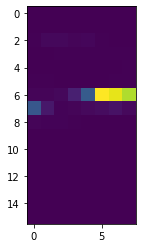

In [18]:
plt.imshow(np.reshape(X_train[5353],(16,8)))

In [35]:
model = Sequential()
model.add(Conv2D(32, (3, 3), padding = "same", activation = "relu", input_shape = input_dim))
model.add(MaxPool2D(pool_size=(2, 2)))

model.add(Conv2D(64, (3, 3), padding = "same", activation = "relu"))
model.add(MaxPool2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(128, (3, 3), padding = "same", activation = "relu"))
model.add(MaxPool2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(1024, activation = "relu"))
model.add(Dropout(0.25))
model.add(Dense(10, activation = "softmax"))
model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_15 (Conv2D)           (None, 16, 8, 32)         320       
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 8, 4, 32)          0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 8, 4, 64)          18496     
_________________________________________________________________
max_pooling2d_16 (MaxPooling (None, 4, 2, 64)          0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 4, 2, 64)          0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 4, 2, 128)         73856     
_________________________________________________________________
max_pooling2d_17 (MaxPooling (None, 2, 1, 128)        

In [36]:
from keras.callbacks import ModelCheckpoint

checkpoint = ModelCheckpoint("model_weights.h5", monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]

hisory=model.fit(X_train, Y_train, epochs = 150, batch_size = 64, validation_data = (X_test, Y_test),callbacks=callbacks_list)

Epoch 1/150
 96/103 [==========================>...] - ETA: 0s - loss: 2.2474 - accuracy: 0.2274
Epoch 00001: val_accuracy improved from -inf to 0.27668, saving model to model_weights.h5
103/103 [==============================] - 1s 6ms/step - loss: 2.2338 - accuracy: 0.2290 - val_loss: 2.0452 - val_accuracy: 0.2767
Epoch 2/150
 98/103 [===========================>..] - ETA: 0s - loss: 2.0027 - accuracy: 0.3141
Epoch 00002: val_accuracy improved from 0.27668 to 0.39808, saving model to model_weights.h5
103/103 [==============================] - 0s 4ms/step - loss: 1.9956 - accuracy: 0.3194 - val_loss: 1.8366 - val_accuracy: 0.3981
Epoch 3/150
 99/103 [===========================>..] - ETA: 0s - loss: 1.7313 - accuracy: 0.4031
Epoch 00003: val_accuracy improved from 0.39808 to 0.44434, saving model to model_weights.h5
103/103 [==============================] - 0s 4ms/step - loss: 1.7286 - accuracy: 0.4043 - val_loss: 1.5979 - val_accuracy: 0.4443
Epoch 4/150
 98/103 [===================

Epoch 27/150
102/103 [============================>.] - ETA: 0s - loss: 0.6662 - accuracy: 0.7760
Epoch 00027: val_accuracy improved from 0.77462 to 0.77920, saving model to model_weights.h5
103/103 [==============================] - 1s 5ms/step - loss: 0.6656 - accuracy: 0.7763 - val_loss: 0.6855 - val_accuracy: 0.7792
Epoch 28/150
 90/103 [=========================>....] - ETA: 0s - loss: 0.6395 - accuracy: 0.7944
Epoch 00028: val_accuracy did not improve from 0.77920
103/103 [==============================] - 0s 4ms/step - loss: 0.6633 - accuracy: 0.7874 - val_loss: 0.8428 - val_accuracy: 0.7393
Epoch 29/150
 90/103 [=========================>....] - ETA: 0s - loss: 0.7047 - accuracy: 0.7743
Epoch 00029: val_accuracy improved from 0.77920 to 0.79386, saving model to model_weights.h5
103/103 [==============================] - 0s 5ms/step - loss: 0.6982 - accuracy: 0.7722 - val_loss: 0.6355 - val_accuracy: 0.7939
Epoch 30/150
 92/103 [=========================>....] - ETA: 0s - loss: 

Epoch 54/150
 98/103 [===========================>..] - ETA: 0s - loss: 0.4657 - accuracy: 0.8642
Epoch 00054: val_accuracy did not improve from 0.84242
103/103 [==============================] - 0s 4ms/step - loss: 0.4643 - accuracy: 0.8641 - val_loss: 0.5655 - val_accuracy: 0.8232
Epoch 55/150
 95/103 [==========================>...] - ETA: 0s - loss: 0.4749 - accuracy: 0.8414
Epoch 00055: val_accuracy did not improve from 0.84242
103/103 [==============================] - 1s 5ms/step - loss: 0.4672 - accuracy: 0.8443 - val_loss: 0.5400 - val_accuracy: 0.8360
Epoch 56/150
 90/103 [=========================>....] - ETA: 0s - loss: 0.4207 - accuracy: 0.8658
Epoch 00056: val_accuracy did not improve from 0.84242
103/103 [==============================] - 0s 5ms/step - loss: 0.4195 - accuracy: 0.8649 - val_loss: 0.5815 - val_accuracy: 0.8323
Epoch 57/150
 98/103 [===========================>..] - ETA: 0s - loss: 0.3793 - accuracy: 0.8758
Epoch 00057: val_accuracy did not improve from 0.8

Epoch 82/150
 98/103 [===========================>..] - ETA: 0s - loss: 0.2883 - accuracy: 0.9058
Epoch 00082: val_accuracy did not improve from 0.86761
103/103 [==============================] - 0s 4ms/step - loss: 0.2898 - accuracy: 0.9058 - val_loss: 0.4660 - val_accuracy: 0.8662
Epoch 83/150
 96/103 [==========================>...] - ETA: 0s - loss: 0.2976 - accuracy: 0.9033
Epoch 00083: val_accuracy did not improve from 0.86761
103/103 [==============================] - 0s 4ms/step - loss: 0.2967 - accuracy: 0.9024 - val_loss: 0.5136 - val_accuracy: 0.8566
Epoch 84/150
 90/103 [=========================>....] - ETA: 0s - loss: 0.2666 - accuracy: 0.9085
Epoch 00084: val_accuracy did not improve from 0.86761
103/103 [==============================] - 0s 4ms/step - loss: 0.2679 - accuracy: 0.9090 - val_loss: 0.5091 - val_accuracy: 0.8630
Epoch 85/150
 94/103 [==========================>...] - ETA: 0s - loss: 0.2643 - accuracy: 0.9129
Epoch 00085: val_accuracy did not improve from 0.8

Epoch 111/150
 90/103 [=========================>....] - ETA: 0s - loss: 0.2448 - accuracy: 0.9234
Epoch 00111: val_accuracy did not improve from 0.87219
103/103 [==============================] - 0s 4ms/step - loss: 0.2478 - accuracy: 0.9226 - val_loss: 0.5049 - val_accuracy: 0.8704
Epoch 112/150
 92/103 [=========================>....] - ETA: 0s - loss: 0.2976 - accuracy: 0.9078
Epoch 00112: val_accuracy did not improve from 0.87219
103/103 [==============================] - 0s 4ms/step - loss: 0.2932 - accuracy: 0.9088 - val_loss: 0.5483 - val_accuracy: 0.8617
Epoch 113/150
 91/103 [=========================>....] - ETA: 0s - loss: 0.2531 - accuracy: 0.9178
Epoch 00113: val_accuracy did not improve from 0.87219
103/103 [==============================] - 0s 5ms/step - loss: 0.2551 - accuracy: 0.9154 - val_loss: 0.4775 - val_accuracy: 0.8653
Epoch 114/150
 89/103 [========================>.....] - ETA: 0s - loss: 0.2374 - accuracy: 0.9228
Epoch 00114: val_accuracy did not improve from

Epoch 140/150
 97/103 [===========================>..] - ETA: 0s - loss: 0.2019 - accuracy: 0.9304
Epoch 00140: val_accuracy did not improve from 0.87907
103/103 [==============================] - 0s 4ms/step - loss: 0.2026 - accuracy: 0.9299 - val_loss: 0.5049 - val_accuracy: 0.8685
Epoch 141/150
100/103 [============================>.] - ETA: 0s - loss: 0.1918 - accuracy: 0.9305
Epoch 00141: val_accuracy did not improve from 0.87907
103/103 [==============================] - 0s 4ms/step - loss: 0.1933 - accuracy: 0.9302 - val_loss: 0.5890 - val_accuracy: 0.8690
Epoch 142/150
 98/103 [===========================>..] - ETA: 0s - loss: 0.2189 - accuracy: 0.9357
Epoch 00142: val_accuracy did not improve from 0.87907
103/103 [==============================] - 0s 4ms/step - loss: 0.2204 - accuracy: 0.9346 - val_loss: 0.6565 - val_accuracy: 0.8662
Epoch 143/150
100/103 [============================>.] - ETA: 0s - loss: 0.3560 - accuracy: 0.9105
Epoch 00143: val_accuracy did not improve from

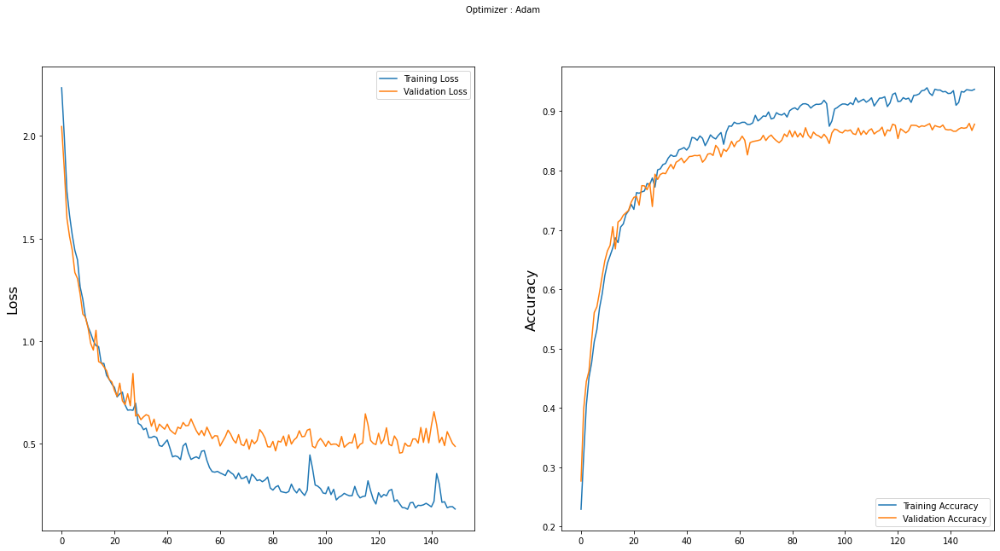

In [37]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.suptitle('Optimizer : Adam', fontsize=10)
plt.ylabel('Loss', fontsize=16)
plt.plot(hisory.history['loss'], label='Training Loss')
plt.plot(hisory.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.ylabel('Accuracy', fontsize=16)
plt.plot(hisory.history['accuracy'], label='Training Accuracy')
plt.plot(hisory.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.show()

In [38]:
predictions = model.predict(X_test)
score = model.evaluate(X_test, Y_test)
print(score)

69/69 [==============================] - 0s 4ms/step - loss: 0.4878 - accuracy: 0.8781
[0.48784637451171875, 0.8781493306159973]


In [39]:
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)

In [40]:
i=11
file_name = '../input/urbansound8k/fold' + str(df["fold"][i]) + '/' + df["slice_file_name"][i]
# Here kaiser_fast is a technique used for faster extraction
X, sample_rate = librosa.load(file_name, res_type='kaiser_fast') 
# We extract mfcc feature from data
mels = np.mean(librosa.feature.melspectrogram(y=X, sr=sample_rate).T,axis=0) 
print(mels.shape)
label=df["classID"][i]
print(label)
mels=np.reshape(mels,(1,16,8,1))
# plt.imshow(mels)
pred=model.predict(mels)
print(np.argmax(pred))

(128,)
8
8
